## Imports

In [4]:
import pandas as pd
import numpy as np
from collections import OrderedDict
from collections import Counter
from itertools import chain

import mysql.connector
import requests
import json
import time
import argparse
from tqdm import tqdm

# OPTIONAL: if you want to have more information on what's happening, activate the logger as follows
import logging
logging.basicConfig(level=logging.INFO)

import matplotlib.pyplot as plt
%matplotlib inline

# Set up display area to show dataframe in jupyter qtconsole
pd.set_option('display.max_rows', 3000)
pd.set_option('display.max_columns', 100)
pd.set_option('display.max_colwidth', None)
pd.options.mode.chained_assignment = None

In [5]:
data = pd.read_csv("../sentence_extraction_and_entity_linking/output/vd_Bercken_et_al_2019/wikipedia_bern_exact_qumls_oc(length)_th08_jaccard_withcontext.csv", sep=";", index_col=["origin","sent_id"]) 
data.head()

sentence  \
origin     sent_id                                                                                                                       
wiki_fully 5                      In 1921, Buck's mother died of a tropical disease, sprue, and shortly afterward her father moved in.   
           6                                                 In 1920, the Bucks had a daughter, Carol, afflicted with phenylketonuria.   
           11                                                              Unable to function, the muscles weaken and exhibit atrophy.   
           12       About 75% of people contracting the disease experience "limb onset" ALS, i.e., first symptoms in the arms or legs.   
           16                                                        North America and Australia have been free of FMD for many years.   

                    entity_count BERN_extracted_ngram BERN_entity_type  \
origin     sent_id                                                       
wiki_fully 5                   1     tropical disease          disease   
           6                   1      phenylketonuria          disease   
           11                  1              atrophy          disease   
           12                  1                  ALS          disease   
           16                  1                  FMD          disease   

                     msh_id  \
origin     sent_id            
wiki_fully 5        Unknown   
           6        D010661   
           11       D055093   
           12       D000690   
           16       D005352   

                                                                      MESHtoCUIs  \
origin     sent_id                                                                 
wiki_fully 5                                                                  []   
           6        ['C0031485', 'C0751434', 'C0268465', 'C0751436', 'C0751435']   
           11                                           ['C2350270', 'C2350271']   
           12                               ['C0002736', 'C0543859', 'C0393554']   
           16                                                       ['C0016052']   

                                                                                                                                                                        BERN_CUI_semtypes  \
origin     sent_id                                                                                                                                                                          
wiki_fully 5                                                                                                                                                                           []   
           6        [{'T047': 'Disease or Syndrome'}, {'T047': 'Disease or Syndrome'}, {'T047': 'Disease or Syndrome'}, {'T047': 'Disease or Syndrome'}, {'T047': 'Disease or Syndrome'}]   
           11                                                                                                          [{'T047': 'Disease or Syndrome'}, {'T047': 'Disease or Syndrome'}]   
           12                                                                         [{'T047': 'Disease or Syndrome'}, {'T047': 'Disease or Syndrome'}, {'T047': 'Disease or Syndrome'}]   
           16                                                                                                                                           [{'T047': 'Disease or Syndrome'}]   

                                                                        BERN_CUI_to_CHV_ID  \
origin     sent_id                                                                           
wiki_fully 5                                                                            []   
           6        [['0000009618', '0000058151'], [], ['0000026313'], [], ['0000048432']]   
           11                                                                     [[], []]   
           12                          

## Reasoning steps for selecting substitution term and calculating similarity score between substitution term and source term

In [6]:
columns_to_convert = ['MESHtoCUIs',
                      'BERN_CUI_semtypes',
                      'BERN_CUI_to_CHV_ID',
                      'BERN_CHV_terms',
                      'BERN_CHV_freq_scores',
                      'exact_match_CUIs',
                      'exact_match_CUI_semtypes',
                      'exact_match_CUI_to_CHV_ID',
                      'exact_match_CHV_terms',
                      'exact_match_CHV_freq_scores',
                      'qumls_CUIs',
                      'qumls_extracted_ngrams',
                      'qumls_matched_terms',
                      'qumls_CUI_semtypes',
                      'qumls_CUI_to_CHV_ID',
                      'qumls_CHV_terms',
                      'qumls_CHV_freq_scores']

# Convert selected columns into lists
for i,column in enumerate(columns_to_convert):
    data[column] = data[column].apply(lambda x: eval(x))
data


sentence  \
origin         sent_id                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       
wiki_fully     5                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                      In 1921, Buck's mother died of a tropical disease, sprue, and shortly afterward her father moved in.   
               6                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                 In 1920, the Bucks had a daughter, Carol, afflicted with phenylketonuria.   
               11                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                              Unable to function, the muscles weaken and exhibit atrophy.   
               12                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       About 75% of people contracting the disease experience "limb onset" ALS, i.e., first symptoms in the arms or legs.   
               16                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                             

In [7]:
substitution_df = data.drop(['entity_count',
                             'BERN_entity_type',
                             'msh_id',
                             'BERN_CUI_semtypes',
#                              'BERN_CHV_freq_scores',
                             'exact_match_CUI_semtypes',
#                              'exact_match_CHV_freq_scores',
                             'qumls_extracted_ngrams',
                             'qumls_matched_terms',
                             'qumls_CUI_semtypes',
#                              'qumls_CHV_freq_scores'
                             'BERN_CUI_to_CHV_ID',
                             'exact_match_CUI_to_CHV_ID',
                             'qumls_CUI_to_CHV_ID',
                            ], axis=1)
substitution_df

sentence  \
origin         sent_id                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       
wiki_fully     5                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                      In 1921, Buck's mother died of a tropical disease, sprue, and shortly afterward her father moved in.   
               6                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                 In 1920, the Bucks had a daughter, Carol, afflicted with phenylketonuria.   
               11                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                              Unable to function, the muscles weaken and exhibit atrophy.   
               12                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       About 75% of people contracting the disease experience "limb onset" ALS, i.e., first symptoms in the arms or legs.   
               16                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                             

In [76]:
print(substitution_df.exact_match_CHV_terms[415])
print(type(substitution_df.exact_match_CHV_terms[415]))

[['trisomy 13'], []]
<class 'list'>


### Pick the best CHV preffered term

#### Previous method

Substitution rules:
1. Take the first CHV term resulted from exact match
2. If the previous doesn't exist, concatenate BERN + QUMLS CHV results. Then take the first CHV term in the overlap array.
3. If there is no overlap, take the first CHV term resulted from BERN MESH ID.
4. If the previous doesn't exist, take the first CHV term resulted from QuickUMLS.

In [819]:
def intersection(lst1, lst2):
    lst1_flat = OrderedDict.fromkeys(list(chain(*lst1)))
    lst2_flat = OrderedDict.fromkeys(list(chain(*lst2)))        
    return [x for x in lst1_flat if x in lst2_flat]

CHV_preferred_terms = {}
CHV_selected_term = {}

for index, row in substitution_df.iterrows():
    print(index, row.sentence)
    print(f'Source term: {row["BERN_extracted_ngram"]}')

    if row["exact_match_CHV_terms"] \
    and not list(row["exact_match_CHV_terms"]).count([]) == len(list(row["exact_match_CHV_terms"])):
        CHV_preferred_terms[index] = row["exact_match_CHV_terms"]
        CHV_selected_term[index] = [item[0] for item in row["exact_match_CHV_terms"] if item][0]
        print(f'Substitution term: {[item[0] for item in row["exact_match_CHV_terms"] if item][0]}')
        print("CHV terms resulted from exact match:")  

    if not row["exact_match_CHV_terms"] \
    or list(row["exact_match_CHV_terms"]).count([]) == len(list(row["exact_match_CHV_terms"])):
        print("no exact match CHV")
#         if (row["BERN_CHV_terms"] and not list(row["BERN_CHV_terms"]).count([]) == len(list(row["BERN_CHV_terms"]))) \
#         and (row["qumls_CHV_terms"] and not list(row["qumls_CHV_terms"]).count([]) == len(list(row["qumls_CHV_terms"]))):
        overlap = intersection(row["BERN_CHV_terms"], row["qumls_CHV_terms"])
        if overlap:
            CHV_preferred_terms[index] = overlap
            CHV_selected_term[index] = overlap[0]
            print(f'Substitution term: {overlap[0]}')
            print("CHV terms resulted from BERN and QUMLS overlap:")
        else:
            if row["BERN_CHV_terms"] and not \
            list(row["BERN_CHV_terms"]).count([]) == len(list(row["BERN_CHV_terms"])):
                CHV_preferred_terms[index] = row["BERN_CHV_terms"]
                CHV_selected_term[index] = [item[0] for item in row["BERN_CHV_terms"] if item][0]
                print(f'Substitution term: {[item[0] for item in row["BERN_CHV_terms"] if item][0]}')
                print("CHV terms resulted from BERN:")
            elif row["qumls_CHV_terms"] and not \
            list(row["qumls_CHV_terms"]).count([]) == len(list(row["qumls_CHV_terms"])):
                CHV_preferred_terms[index] = row["qumls_CHV_terms"]
                CHV_selected_term[index] = [item[0] for item in row["qumls_CHV_terms"] if item][0]
                print(f'Substitution term: {[item[0] for item in row["qumls_CHV_terms"] if item][0]}')
                print("CHV terms resulted from QUMLS:")
            else:
                print("no BERN or QUMLS CHV")
                CHV_preferred_terms[index] = None
                CHV_selected_term[index] = None
                
    print(CHV_preferred_terms[index])
    print(" ")

substitution_df["CHV_preferred_terms"] = CHV_preferred_terms.values()
substitution_df["CHV_selected_term"] = CHV_selected_term.values()
                  

5 In 1921, Buck's mother died of a tropical disease, sprue, and shortly afterward her father moved in.
Source term: tropical disease
no exact match CHV
Substitution term: disease
CHV terms resulted from QUMLS:
[['disease']]
 
6 In 1920, the Bucks had a daughter, Carol, afflicted with phenylketonuria.
Source term: phenylketonuria
Substitution term: phenylketonuria (PKU)
CHV terms resulted from exact match:
[['phenylketonuria (PKU)', 'phenylketonuria (PKU)'], []]
 
11 Unable to function, the muscles weaken and exhibit atrophy.
Source term: atrophy
Substitution term: atrophy
CHV terms resulted from exact match:
[['atrophy', 'atrophic']]
 
12 About 75% of people contracting the disease experience ''limb onset'' ALS, i.e., first symptoms in the arms or legs.
Source term: ALS
Substitution term: Lou Gehrig's disease (ALS)
CHV terms resulted from exact match:
[["Lou Gehrig's disease (ALS)"]]
 
16 North America and Australia have been free of FMD for many years.
Source term: FMD
Substitution te

Substitution term: heart attack
CHV terms resulted from exact match:
[['heart attack']]
 
535 At one time he contracted tuberculosis and spent a year in a sanitorium.
Source term: tuberculosis
Substitution term: tuberculosis (TB)
CHV terms resulted from exact match:
[['tuberculosis (TB)', 'tuberculous']]
 
540 Antibiotics have no effect against viral infections and thus have no effect against the viruses that cause the common cold.
Source term: viral infections
Substitution term: viral infection
CHV terms resulted from exact match:
[['viral infection']]
 
543 The common cold is a viral infection of the upper respiratory tract.
Source term: viral infection of the upper respiratory tract
no exact match CHV
Substitution term: respiratory tract infection (RTI)
CHV terms resulted from BERN:
[['respiratory tract infection (RTI)'], ['common cold']]
 
547 Due to lack of studies, it is not known whether increased fluid intake improves symptoms or shortens respiratory illness and a similar lack 

CHV terms resulted from exact match:
[['plague']]
 
1015 Lead guitarist Paul Kossoff formed Back Street Crawler and died from a drug-induced heart failure at the age of 25 in 1976.
Source term: heart failure
Substitution term: heart failure
CHV terms resulted from exact match:
[['heart failure', 'cardiac insufficiency'], ['congestive heart failure (CHF)']]
 
1017 On 17 November 1974, just after making a speech to the Royal College of Physicians in Dublin, Childers suffered a heart attack.
Source term: heart attack
Substitution term: heart attack
CHV terms resulted from exact match:
[['heart attack']]
 
1018 He died on September 22, 1999, aged 71, of a ruptured abdominal aortic aneurysm.
Source term: ruptured abdominal aortic aneurysm
no exact match CHV
no BERN or QUMLS CHV
None
 
1024 The canes were also used to keep people away, to remove clothing from plague victims without having to touch them, and to take a patient's pulse.
Source term: plague
Substitution term: plague
CHV terms re

Substitution term: heart attack
CHV terms resulted from exact match:
[['heart attack']]
 
1560 The leaves and bark are used for controlling blood pressure and gingivitis.
Source term: gingivitis
Substitution term: gum inflammation
CHV terms resulted from exact match:
[['gum inflammation']]
 
1564 The posterior pituitary (or neurohypophysis) is a lobe of the gland that is functionally connected to the hypothalamus by the median eminence via a small tube called the pituitary stalk (also called the infundibular stalk or the infundibulum).
Source term: neurohypophysis
no exact match CHV
no BERN or QUMLS CHV
None
 
1566 The main story of the episode's first act sees Bart get appendicitis from eating a jagged metal Krusty-O.
Source term: appendicitis
Substitution term: appendicitis
CHV terms resulted from exact match:
[['appendicitis']]
 
1567 He stated that ''you ca n't get'' appendicitis from eating a piece of metal, but the writers decided to do it anyway.
Source term: appendicitis
Substi

2075 However, the entire spectrum of ultraviolet radiation has some of the biological features of ionizing radiation: It does far more damage to many molecules in biological systems than is accounted for by simple heating effects (an example is sunburn).
Source term: sunburn
Substitution term: sunburn
CHV terms resulted from exact match:
[['sunburn'], []]
 
2078 Birley et al. report that excessive washing with soap may dry the mucous membrane that covers the glans penis and cause non-specific dermatitis.
Source term: non-specific dermatitis
no exact match CHV
Substitution term: skin inflammation
CHV terms resulted from BERN and QUMLS overlap:
['skin inflammation']
 
2081 Getty lived the rest of his life in the British Isles, dying of heart failure at the age of 83 on June 6, 1976.
Source term: heart failure
Substitution term: heart failure
CHV terms resulted from exact match:
[['heart failure', 'cardiac insufficiency'], ['congestive heart failure (CHF)']]
 
2082 On August 19, 1905, Bou

__Remarks:__

112 Once at Richmond, Madison began drafting the Report, though he was delayed by a weeklong battle with dysentery. \
Source term: dysentery \
Substitution term: dysentery \
CHV terms resulted from exact match: \
[['dysentery', 'infectious diarrhea']]

__162 As a result, the affected area of the brain can not function normally, which might result in an inability to move one or more limbs on one side of the body, failure to understand or formulate speech, or a vision impairment of one side of the visual field. \
Source term: vision impairment of one side of the visual field \
no exact match CHV \
Substitution term: hemeralopia \
CHV terms resulted from BERN: \
[['hemeralopia'], ['vision disorders'], ['macropsia'], ['metamorphopsia'], ['micropsia'], [], ['vision problem', 'visual defect']]__ \
Substitution term: cannot see properly \
CHV terms resulted from BERN and QUMLS overlap: \
['cannot see properly', 'vision problem', 'visual defect', 'blindness']

338 Surgical subspecialties include neurosurgery, ophthalmology, orthopedic surgery, (ENT) and facial plastic surgery, plastic surgery, thoracic surgery, transplantation, Trauma, urology, and vascular surgery. \
Source term: Trauma \
Substitution term: trauma \
CHV terms resulted from exact match: \
[['trauma'], ['injuries wounds'], ['injury from an external force']]

__372 When Robert was one year old, his father died in the flu pandemic of 1918. \
Source term: flu pandemic \
no exact match CHV \
Substitution term: myalgic encephalomyelitis \
CHV terms resulted from BERN: \
[['myalgic encephalomyelitis', 'chronic fatigue syndrome (CFS)', 'postviral fatigue']]__ \
Substitution term: chronic fatigue syndrome (CFS) \
CHV terms resulted from BERN: \
[['chronic fatigue syndrome (CFS)', 'myalgic encephalomyelitis', 'postviral fatigue']] 

__547 Due to lack of studies, it is not known whether increased fluid intake improves symptoms or shortens respiratory illness and a similar lack of data exists for the use of heated humidified air. \
Source term: respiratory illness \
no exact match CHV \
Substitution term: lung crackles \
CHV terms resulted from BERN: \
[['lung crackles'], ['pleural rub'], ['rhonchi'], ['stridor'], ['wheezing']]__

598 Khan died on the night between 25/26 December 1942, of a sudden heart failure, at his home. \
Source term: sudden heart failure \
no exact match CHV \
Substitution term: heart failure \
CHV terms resulted from QUMLS: \
[['heart failure', 'cardiac insufficiency'], ['heart failure', 'cardiac insufficiency'], ['congestive heart failure (CHF)']]

606 Strangling does not have to be fatal; limited or interrupted strangling is practiced in erotic asphyxia, in the choking game, and is an important technique in many combat sports and self-defence systems. \
Source term: erotic asphyxia \
no exact match CHV \
Substitution term: asphyxia \
CHV terms resulted from BERN: \
[['asphyxia']]

672 Interest in the relationship between psychiatric syndromes or symptoms and immune function has been a consistent theme since the beginning of modern medicine. \
Source term: psychiatric syndromes \
no exact match CHV \
Substitution term: behavior disorder \
CHV terms resulted from BERN: \
[['behavior disorder'], ['mental illness', 'mental dysfunction'], ['psychiatric diagnosis'], []]

__749 It is possible for the frenulum of the penis to tear during sexual activity. \
Source term: frenulum of the penis \
no exact match CHV \
Substitution term: penile neoplasm \
CHV terms resulted from BERN: \
[['penile neoplasm'], ['penile cancer']]__

916 The yellowing of the ''white of the eye'' is thus more properly termed conjunctival icterus. \
Source term: conjunctival icterus \
no exact match CHV \
Substitution term: conjunctival diseases \
CHV terms resulted from QUMLS: \
[['conjunctival diseases'], ['jaundice']]

__957 However, influenza C is less common than the other types and usually seems to cause mild disease in children. \
Source term: influenza C \
no exact match CHV \
Substitution term: hepatitis C \
CHV terms resulted from BERN: \
[['hepatitis C', 'hepatitis non-a non-b']]__

1072 The absence of the auditory ossicles would constitute a moderate-to-severe hearing loss. \
Source term: hearing loss \
Substitution term: partial hearing loss \
CHV terms resulted from exact match: \
[['partial hearing loss'], ['partial hearing loss'], ['deafness', 'complete hearing loss'], []]

__1207 Chlamydia can be transmitted during vaginal, anal, or oral sex, and can be passed from an infected mother to her baby during childbirth. \
Source term: Chlamydia \
no exact match CHV \
no BERN or QUMLS CHV \
None__ \
=> 'chlamydia' (C0008148) has semantic type  {'T007': 'Bacterium'} in the UMLS and therefore it's not translated to CHV term because we have set our restriction to the semantic types of the group 'disorders'

__1527 Henry's obesity hastened his death at the age of 55, which occurred on 28 January 1547 in the Palace of Whitehall, on what would have been his father's 90th birthday. \
Source term: Henry \
no exact match CHV \
no BERN or QUMLS CHV \
None__ \
=> This is just a fail of BERN

\
\
__Good examples:__

341 It is a major cause of lower respiratory tract infections and hospital visits during infancy and childhood. \
Source term: lower respiratory tract infections \
Substitution term: chest cold \
CHV terms resulted from exact match: \
[['chest cold']]

415 Patau syndrome affects somewhere between 1 in 10,000 and 1 in 21,700 live births. \
Source term: Patau syndrome \
Substitution term: trisomy 13 \
CHV terms resulted from exact match: \
[['trisomy 13'], []]

#### New method

Substitution rules:
1. Merge CHV terms resulted from all three methods (exact string matching, BERN MeSH IDs, QuickUMLS) into a list
2. Count the occurence frequency of each term in the merged list
3. Sort on the occurence frequency votes and the CHV frequency scores
4. Take the first candidate in the sorted list as the CHV substitution term
    - However, if the first term and second term's frequency votes are tied, take the term that has a higher CHV frequency scores that is above the set threshold (>=0.5).


In [81]:
def get_sorted_voted_terms(exact_list, bern_list, qumls_list, exact_freq, bern_freq, qumls_freq):
    # Flatten the lists and converting them to sets
    exact_list_flat = OrderedDict(zip(chain(*exact_list), chain(*exact_freq)))
    bern_list_flat = OrderedDict(zip(chain(*bern_list), chain(*bern_freq)))
    qumls_list_flat = OrderedDict(zip(chain(*qumls_list), chain(*qumls_freq)))
    voted_terms = Counter(list(exact_list_flat.items()) + list(bern_list_flat.items()) + list(qumls_list_flat.items()))
    
    if bern_list_flat and not exact_list_flat and not qumls_list_flat:
        # if there's only BERN CHV results, don't consider sorting on freq. score
        sorted_voted_terms_on_freq_scores = sorted(voted_terms.items(), key= lambda t: (t[1]), reverse=True)
        print("Only BERN results.")
    elif qumls_list_flat and not exact_list_flat and not bern_list_flat:
        # if there's only QUMLS CHV results, don't consider sorting on freq. score
        sorted_voted_terms_on_freq_scores = sorted(voted_terms.items(), key= lambda t: (t[1]), reverse=True)
        print("Only QUMLS results.")
    else:
        # sort on overlap count (votes) and freq. score of terms
        sorted_voted_terms_on_freq_scores = sorted(voted_terms.items(), key= lambda t: (t[1], t[0][1]), reverse=True)
    
#     print(qumls_list_flat)
#     print(voted_terms)
#     print(sorted_voted_terms_on_freq_scores)
    
    return sorted_voted_terms_on_freq_scores

CHV_selection = {}
CHV_substitution = {}

for index, row in substitution_df.iterrows():
    print(index, row.sentence)
    print('Source term: {}'.format(row["BERN_extracted_ngram"]))
    
    sorted_voted_terms = get_sorted_voted_terms(row["exact_match_CHV_terms"], row["BERN_CHV_terms"], row["qumls_CHV_terms"], \
                                               row["exact_match_CHV_freq_scores"], row["BERN_CHV_freq_scores"], row["qumls_CHV_freq_scores"])    
    
    print(sorted_voted_terms) # e.g. [(('tuberculous', 0.118189908), 3), (('tuberculosis (TB)', -1.0), 3)]
    
    ranked_terms = []
    for item in sorted_voted_terms:
        ranked_terms.append(item[0][0])
    CHV_selection[index] = ranked_terms
    
    takeLastTerm = False
    if len(sorted_voted_terms) > 1:
        for i in range(len(sorted_voted_terms)-1):
            takeLastTerm = True
            # If votes of current term is higher than votes of next term
            if sorted_voted_terms[i][1] > sorted_voted_terms[i+1][1]:
                CHV_substitution[index] = sorted_voted_terms[i][0][0]
                print("more votes")
                print(f'Substitution term: {sorted_voted_terms[i][0][0]}')
                takeLastTerm = False
                break
            # If votes of current term and votes of next term are equal
            elif sorted_voted_terms[i][1] == sorted_voted_terms[i+1][1]:
                # If the current term has a freq. score lower than the threshold, but not -1,
                # AND the next term's freq. score is equal or higher than the threshold, or is -1,
                # then continue to the next term.
                if (sorted_voted_terms[i][0][1] < 0.5 and not sorted_voted_terms[i][0][1] == -1.0) \
                and (sorted_voted_terms[i+1][0][1] >= 0.5 or sorted_voted_terms[i+1][0][1] == -1.0):
                    print("lower than threshold, skip")
                    continue
                # Take current term which met the threshold criteria
                print("threshold criteria is met or next one is not higher than threshold")
                CHV_substitution[index] = sorted_voted_terms[i][0][0]
                print(f'Substitution term: {sorted_voted_terms[i][0][0]}')
                takeLastTerm = False
                break              
        if takeLastTerm == True:
            takeLastTerm = False
            CHV_substitution[index] = sorted_voted_terms[i+1][0][0]
            print("take last term")
            print(f'Substitution term: {sorted_voted_terms[i+1][0][0]}')
    elif len(sorted_voted_terms) == 1:
        CHV_substitution[index] = sorted_voted_terms[0][0][0]
        print(f'Substitution term: {sorted_voted_terms[0][0][0]}')
    else:
        CHV_substitution[index] = None
        print(f'Substitution term: None')
    
    print(" ")
        

substitution_df["CHV_selection"] = CHV_selection.values()
substitution_df["CHV_substitution"] = CHV_substitution.values()
    

5 In 1921, Buck's mother died of a tropical disease, sprue, and shortly afterward her father moved in.
Source term: tropical disease
Only QUMLS results.
[(('disease', 1.0), 1)]
Substitution term: disease
 
6 In 1920, the Bucks had a daughter, Carol, afflicted with phenylketonuria.
Source term: phenylketonuria
[(('phenylketonuria (PKU)', -1.0), 3), (('dhpr deficiency', -1.0), 1), (('hyperphenylalaninemia', -1.0), 1)]
more votes
Substitution term: phenylketonuria (PKU)
 
11 Unable to function, the muscles weaken and exhibit atrophy.
Source term: atrophy
[(('atrophy', 0.464369933), 2), (('atrophic', 0.166994873), 2)]
threshold criteria is met or next one is not higher than threshold
Substitution term: atrophy
 
12 About 75% of people contracting the disease experience ''limb onset'' ALS, i.e., first symptoms in the arms or legs.
Source term: ALS
[(("Lou Gehrig's disease (ALS)", -1.0), 2)]
Substitution term: Lou Gehrig's disease (ALS)
 
16 North America and Australia have been free of FMD 

[(('depressive disorder', 0.663750497), 2), (('mental depression', 0.56156364), 2), (('sadness', 0.481935087), 2), (('depression nos', -1.0), 2)]
threshold criteria is met or next one is not higher than threshold
Substitution term: depressive disorder
 
942 On Christmas Eve 1992, Peyo died of a heart attack in Brussels at age 64.
Source term: heart attack
[(('heart attack', 0.927278218), 3)]
Substitution term: heart attack
 
945 A measles epidemic and food shortages during 1900 reduced the population of the area by one-third.
Source term: measles
[(('Measles disease', -1.0), 3)]
Substitution term: Measles disease
 
946 Coombs suffered a stroke on September 10, 2001, and died on September 18, 2001 at the age of 73.
Source term: stroke
[(('stroke', 0.799621631), 3), (('acute stroke', 0.612045288), 1)]
more votes
Substitution term: stroke
 
948 If the stressful conditions persist, the polyp eventually dies.
Source term: polyp
[(('polyp', 0.403297679), 2)]
Substitution term: polyp
 
950 Fu

Source term: heart attack
[(('heart attack', 0.927278218), 3)]
Substitution term: heart attack
 
2026 As the infection progresses, muscle spasms develop in the jaw (thus the name lockjaw) and elsewhere in the body.
Source term: muscle spasms
[(('spasm', 0.447227464), 3), (('ciliary spasm', -1.0), 1)]
more votes
Substitution term: spasm
 
2028 The name Vibrio derives from Filippo Pacini who isolated microorganisms he called ''vibrions'' from cholera patients in 1854, because of their motility.
Source term: cholera
[(('cholera', 0.480259653), 3)]
Substitution term: cholera
 
2029 Vibrio is a genus of Gram-negative bacteria possessing a curved rod shape (comma shape), several species of which can cause foodborne infection, usually associated with eating undercooked seafood.
Source term: foodborne infection
[(('infection', 0.95085228), 2), (('infectious disease', 0.8807686), 1)]
more votes
Substitution term: infection
 
2037 There might be a gender difference in reporting rates of sick bui

__Remarks:__

__11 Unable to function, the muscles weaken and exhibit atrophy. \
Source term: atrophy \
[(('atrophy', 0.464369933), 2), (('atrophic', 0.166994873), 2)] \
Substitution term: atrophic \
=> Tried threshold of 0.5, is too high, 0.4 is probably better__
11 Unable to function, the muscles weaken and exhibit atrophy. \
Source term: atrophy \
[(('atrophy', 0.464369933), 2), (('atrophic', 0.166994873), 2)] \
threshold criteria is met or next one is not higher than threshold \
Substitution term: atrophy \
=> next one is also lower than the threshold of 0.5, so the current term is taken.

__214 Examples of the second type are the Hepadnaviridae, which includes Hepatitis B virus. \
Source term: Hepatitis B virus \
[(('hepatitis C', 0.868028688), 1), (('hepatitis B', 0.8559618), 1), (('hepatitis e', 0.580874075), 1), (('hepatitis g', 0.559038998), 1), (('hepatitis d', 0.552329278), 1), (('viral hepatitis b', -1.0), 1), (('hepatitis a', -1.0), 1), (('infectious hepatitis', -1.0), 1), (('hepatitis viral', -1.0), 1), (('hepatitis non-a non-b', -1.0), 1), (('hepatitis h', -1.0), 1)] \
Substitution term: hepatitis C \
=> Freq. score of hepatitis C is higher than hepatitis B, this is bad. However CUI_SCORE (0.5593) of hep B is higher than CUI_SCORE (0.5443) of hep C in MRSAT. Take CUI_SCORE as well?__ \
=> No.. if there's only result for either QUMLS or BERN then we don't take freq. score in consideration. \
214 Examples of the second type are the Hepadnaviridae, which includes Hepatitis B virus. \
Source term: Hepatitis B virus \
[(('hepatitis B', 0.8559618), 1), (('viral hepatitis b', -1.0), 1), (('hepatitis d', 0.552329278), 1), (('hepatitis a', -1.0), 1), (('infectious hepatitis', -1.0), 1), (('hepatitis viral', -1.0), 1), (('hepatitis C', 0.868028688), 1), (('hepatitis non-a non-b', -1.0), 1), (('hepatitis e', 0.580874075), 1), (('hepatitis g', 0.559038998), 1), (('hepatitis h', -1.0), 1)] \
Substitution term: hepatitis B

258 This was despite his worsening colitis,. \
Source term: colitis \
[(('colitis', 0.367620729), 3), (('colon (non-specific) inflammation', -1.0), 3)] \
Substitution term: colitis \
=> Maybe set the threshold for the freq. score higher? (Now it's 0.3)

__472 Both girls caught typhus and Jane nearly died. \
Source term: typhus \
[(('typhus', 0.259803212), 3), (('typhoid fever', 0.565422803), 1), (('epidemic typhus', -1.0), 1)] \
Substitution term: typhoid fever \
=> term with most votes should be ranked first__ \
472 Both girls caught typhus and Jane nearly died. \
Source term: typhus \
[(('typhus', 0.259803212), 3), (('typhoid fever', 0.565422803), 1), (('epidemic typhus', -1.0), 1)] \
Substitution term: typhus

509 He died of senile dementia in the Fremantle Lunatic Asylum (now the Fremantle Arts Centre building) on 13 August 1900, and was buried in Fremantle Cemetery. \
Source term: senile dementia \
[(("Alzheimer's disease", 0.590454007), 3), (('alzheimers dementia', -1.0), 3), (('senile dementia', 0.317599149), 2), (('presenile dementia', -1.0), 2), (('presenile alzheimer dementia', -1.0), 1), (('familial alzheimer disease', -1.0), 1)] \
Substitution term: Alzheimer's disease

645 Olga Alexandrovna said she believed all four of her nieces bled more than was normal and believed they were carriers of the hemophilia gene, like their mother. \
Source term: hemophilia \
[(('hemophilia a', -1.0), 3), (('hemophilia', 0.336636833), 2), (('hemophilia b', 0.67643252), 1), (('factor xi deficiency', 0.4665399), 1)] \
Substitution term: hemophilia a

658 Saint-Amant wanted a third match, but Staunton was initially unwilling as he had developed heart trouble during the second match. \
Source term: heart trouble \
[(('heart disease', 0.972132598), 2), (('heart problem', 0.853617601), 2), (('heart trouble', -1.0), 2), (('heart injury', -1.0), 1)] \
Substitution term: heart disease
=> heart disease CUI_SCORE 0.6108 COMBO_SCORE 0.791466299 COMBO_SCORE_NO_TOP_WORDS 0.791466299
=> heart problem CUI_SCORE 0.7022 COMBO_SCORE 0.8519392 COMBO_SCORE_NO_TOP_WORDS 0.805505867

__973 Elisabeth Therese died at the Palace of Venaria aged 29, having fallen ill with puerperal fever after childbirth. \
Source term: puerperal fever \
[(('puerperal fever', 0.425610777), 2), (('postpartum fever', -1.0), 2)] \
lower than threshold, skip \
Substitution term: postpartum fever \
last term \
=> set threshold on 0.4__

__1035 He died in Springfield, Missouri, at Cox South Hospital, from an abdominal aortic aneurysm, aged 59, two months before the release of what would be his final studio album, Final Touches. \
Source term: abdominal aortic aneurysm \
[(('abdominal aneurysm', 0.473870089), 3), (('abdominal aortic aneurysm (AAA)', -1.0), 3)] \
lower than threshold, skip \
Substitution term: abdominal aortic aneurysm (AAA) \
last term \
=> set threshold on 0.4__

2104 Allergic skin reactions can also occur. \
Source term: Allergic skin reactions \
[(('allergy', 0.836777069), 1), (('hypersensitivity', 0.310206981), 1), (('hypersensitivity symptom', -1.0), 1), (('allergic skin reaction', -1.0), 1)] \
Substitution term: allergy

2105 During the shows in Sweden, Joacim Cans caught a serious throat infection which made it impossible for him to sing. \
Source term: throat infection \
[(('pharyngitis', 0.23020408), 2), (('throat inflammation', -1.0), 2), (('inflamed throat', -1.0), 2)] \
lower than threshold, skip \
lower than threshold, skip \
Substitution term: inflamed throat \
last term \
2105 During the shows in Sweden, Joacim Cans caught a serious throat infection which made it impossible for him to sing. \
Source term: throat infection \
[(('pharyngitis', 0.23020408), 2), (('throat inflammation', -1.0), 2), (('inflamed throat', -1.0), 2)] \
lower than threshold, skip \
threshold criteria is met or next one is not higher than threshold \
Substitution term: throat inflammation

2121 A few days later Ho went into cardiac arrest. \
Source term: cardiac arrest \
[(('cardiac arrest', -1.0), 3), (('heart arrest', -1.0), 3), (('cardiopulmonary arrest', 0.468806923), 1)] \
lower than threshold, skip \
more votes \
Substitution term: heart arrest

2125 Ho was diagnosed with cardiomyopathy in 2005 and had a pacemaker implanted. \
Source term: cardiomyopathy \
[(('myocardial disease', -1.0), 2), (('heart muscle disease', -1.0), 2)] \
higher than threshold \
Substitution term: myocardial disease

__2135 For men with IC, pain occurs at the moment of ejaculation and is focused at the tip of the penis. \
Source term: IC \
[(('primary ciliary dyskinesia', 0.419704154), 1), (('myocardial ischemia', 0.277455217), 1), (('inspiratory capacity', -1.0), 1), (('interstitial cystitis (IC)', -1.0), 1)] \
Substitution term: primary ciliary dyskinesia \
=> threshold 0.5?__ \
=> as it is right now if it's not higher than the threshold and the next one is also not then the current one is taken.\
2135 For men with IC, pain occurs at the moment of ejaculation and is focused at the tip of the penis. \
Source term: IC \
[(('primary ciliary dyskinesia', 0.419704154), 1), (('myocardial ischemia', 0.277455217), 1), (('inspiratory capacity', -1.0), 1), (('interstitial cystitis (IC)', -1.0), 1)] \
threshold criteria is met or next one is not higher than threshold \
Substitution term: primary ciliary dyskinesia

2215 Acephalgic migraines can occur in individuals of any age. \
Source term: Acephalgic migraines \
[(('acephalgic migraine', -1.0), 3), (('complicated migraine', 0.447508612), 1), (('basilar migraine', 0.393542865), 1), (('migraine with prolonged aura', -1.0), 1), (('migraine aura', -1.0), 1)] \
more votes \
Substitution term: acephalgic migraine

__Good:__

258 This was despite his worsening colitis,. \
Source term: colitis \
[(('colitis', 0.367620729), 3), (('colon (non-specific) inflammation', -1.0), 3)] \
lower than threshold, skip \
Substitution term: colon (non-specific) inflammation \
last term \

316 On 13 March 1798, Weber's mother died of tuberculosis. \
Source term: tuberculosis \
[(('tuberculous', 0.118189908), 3), (('tuberculosis (TB)', -1.0), 3)] \
lower than threshold, skip \
Substitution term: tuberculosis (TB) \
last term

435 Porter's mother died in 1952, and his wife died from emphysema in 1954.\
Source term: emphysema \
[(('abnormal collection of air in tissues', -1.0), 3), (('lung emphysema', -1.0), 2)] \
Substitution term: abnormal collection of air in tissues

483 It was first used to treat malaria in Rome in 1631. \
Source term: malaria \
[(('malaria', 0.521907095), 2), (('malarial fever', -1.0), 2)] \
Substitution term: malaria \
=> So threshold should def not be higher than 0.6, like in the paper of Zheng-Treitler about the translator(2007).

521 The association publishes various journals and pamphlets, as well as the Diagnostic and Statistical Manual of Mental Disorders (DSM). \
Source term: Mental Disorders \
[(('mental illness', 0.767621331), 3), (('mental dysfunction', -1.0), 3), (('behavior disorder', 0.592972624), 1), (('psychiatric diagnosis', -1.0), 1), (('tooth diseases', -1.0), 1)] \
Substitution term: mental illness

1520 A Crafoord Prize is only awarded for polyarthritis when a special committee decides that substantial progress in the field has been made. \
Source term: polyarthritis \
[(('polyarthritis', 0.105735939), 3), (('polyarticular arthritis', -1.0), 3), (('arthritis', 0.805993266), 2)] \
lower than threshold, skip \
more votes \
Substitution term: polyarticular arthritis

2136 It is important to establish whether the dyspareunia is acquired or congenital and whether it is generalized (complete) or situational. \
Source term: dyspareunia \
[(('painful intercourse', 0.575695355), 2), (('dyspareunia', 0.093898188), 2)] \
Substitution term: painful intercourse

2157 A physical examination is performed to look for typical signs of pulmonary hypertension. \
Source term: pulmonary hypertension \
[(('hypertension caused by lung disease', -1.0), 3)] \
Substitution term: hypertension caused by lung disease

In [78]:
substitution_df

,sentence,BERN_extracted_ngram,MESHtoCUIs,BERN_CHV_terms,BERN_CHV_freq_scores,exact_match_CUIs,exact_match_CHV_terms,exact_match_CHV_freq_scores,qumls_CUIs,qumls_CHV_terms,qumls_CHV_freq_scores,CHV_selection,CHV_substitution
sent_id,,,,,,,,,,,,,
5,"In 1921, Buck's mother died of a tropical disease, sprue, and shortly afterward her father moved in.",tropical disease,[],[],[],[C1336827],[[]],[[]],"[C0445334, C0012634]",[[disease]],[[1.0]],[disease],disease
6,"In 1920, the Bucks had a daughter, Carol, afflicted with phenylketonuria.",phenylketonuria,"[C0031485, C0751434, C0268465, C0751436, C0751435]","[[phenylketonuria (PKU), phenylketonuria (PKU)], [], [dhpr deficiency], [], [hyperphenylalaninemia]]","[[-1.0, -1.0], [], [-1.0], [], [-1.0]]","[C0031485, C0751434]","[[phenylketonuria (PKU), phenylketonuria (PKU)], []]","[[-1.0, -1.0], []]","[C0031485, C0031485, C0751434]","[[phenylketonuria (PKU), phenylketonuria (PKU)], [phenylketonuria (PKU), phenylketonuria (PKU)], []]","[[-1.0, -1.0], [-1.0, -1.0], []]","[phenylketonuria (PKU), dhpr deficiency, hyperphenylalaninemia]",phenylketonuria (PKU)
11,"Unable to function, the muscles weaken and exhibit atrophy.",atrophy,"[C2350270, C2350271]","[[], []]","[[], []]",[C0333641],"[[atrophy, atrophic]]","[[0.464369933, 0.166994873]]",[C0333641],"[[atrophy, atrophic]]","[[0.464369933, 0.166994873]]","[atrophy, atrophic]",atrophy
12,"About 75% of people contracting the disease experience ''limb onset'' ALS, i.e., first symptoms in the arms or legs.",ALS,"[C0002736, C0543859, C0393554]","[[Lou Gehrig's disease (ALS)], [], []]","[[-1.0], [], []]","[C0002736, C1704945, C1456383, C0003372]",[[Lou Gehrig's disease (ALS)]],[[-1.0]],[],[],[],[Lou Gehrig's disease (ALS)],Lou Gehrig's disease (ALS)
16,North America and Australia have been free of FMD for many years.,FMD,[C0016052],[[fibromuscular dysplasia]],[[0.187964293]],"[C0238288, C3810599, C4085863, C4281559, C0016052]","[[], [], [fibromuscular dysplasia]]","[[], [], [0.187964293]]",[],[],[],[fibromuscular dysplasia],fibromuscular dysplasia
19,"There is an increased risk of STI transmission if the receiving partner has wounds on his genitals, or if the giving partner has wounds or open sores on or in his or her mouth, or bleeding gums.",STI,[],[],[],[C0036916],[[sexually transmitted diseases (STDs)]],[[-1.0]],[],[],[],[sexually transmitted diseases (STDs)],sexually transmitted diseases (STDs)
30,"Hyssop is also used, usually in combination with other herbs such as liquorice, in herbal remedies, especially for lung conditions.",lung conditions,[C0024115],[[lung disease]],[[0.869140091]],[],[],[],"[C0012634, C0024109]",[[disease]],[[1.0]],"[disease, lung disease]",disease
31,Skin allergy testing (such as patch testing) is available for certain foods and venoms.,Skin allergy,[],[],[],[C0585186],[[skin allergy]],[[0.593454691]],[C0585186],[[skin allergy]],[[0.593454691]],[skin allergy],skin allergy
34,Rarely very low blood pressure may be the only sign of anaphylaxis.,anaphylaxis,[C0002792],[[]],[[]],"[C0002792, C4316895]","[[], [allergic shock]]","[[], [-1.0]]","[C0002792, C4316895, C0002792, C4316895]","[[], [allergic shock], [], [allergic shock]]","[[], [-1.0], [], [-1.0]]",[allergic shock],allergic shock


### Calculate lexical similarity

#### Dice similarity

In [335]:
def letterPairs ( chain ):

    listOfCharacters = list(chain)
    pairs = []

    while len(listOfCharacters)>1:
        pairs.append(listOfCharacters[0]+listOfCharacters[1])
        del(listOfCharacters[0])

    return pairs

def wordLetterPairs(sentence):


    allPairs = []
    words = sentence.split()
    for w in words:
        pairsInWord = letterPairs(w)
        for p in pairsInWord:
            allPairs.append(p)
    return allPairs


def compareStrings(s1, s2):

    pairs1 = wordLetterPairs(s1.upper())
    print(pairs1)
    pairs2 = wordLetterPairs(s2.upper())
    print(pairs2)
    intersection = 0
    union = len(pairs1)+len(pairs2)
    for p1 in pairs1:
        for p2 in pairs2:
            if p1 == p2:
                intersection +=1
                pairs2.remove(p2)
                break
    if intersection == 0 or union == 0:
        simVal = 0
    else:
        simVal = ((2.0*intersection)/union)

    return simVal


In [336]:
# Calculate lexical similarity between source term and substitution term
simVal = compareStrings('tropical disease', 'disease')
simVal

['TR', 'RO', 'OP', 'PI', 'IC', 'CA', 'AL', 'DI', 'IS', 'SE', 'EA', 'AS', 'SE']
['DI', 'IS', 'SE', 'EA', 'AS', 'SE']


0.631578947368421

In [339]:
simVal = compareStrings('phenylketonuria', 'phenylketonuria (PKU)')
simVal

['PH', 'HE', 'EN', 'NY', 'YL', 'LK', 'KE', 'ET', 'TO', 'ON', 'NU', 'UR', 'RI', 'IA']
['PH', 'HE', 'EN', 'NY', 'YL', 'LK', 'KE', 'ET', 'TO', 'ON', 'NU', 'UR', 'RI', 'IA', '(P', 'PK', 'KU', 'U)']


0.875

In [340]:
simVal = compareStrings('anaphylaxis', 'allergic shock')
simVal

['AN', 'NA', 'AP', 'PH', 'HY', 'YL', 'LA', 'AX', 'XI', 'IS']
['AL', 'LL', 'LE', 'ER', 'RG', 'GI', 'IC', 'SH', 'HO', 'OC', 'CK']


0

In [337]:
simVal = compareStrings('abdominal wall', 'wall of abdomen')
simVal

['AB', 'BD', 'DO', 'OM', 'MI', 'IN', 'NA', 'AL', 'WA', 'AL', 'LL']
['WA', 'AL', 'LL', 'OF', 'AB', 'BD', 'DO', 'OM', 'ME', 'EN']


0.6666666666666666

In [338]:
simVal = compareStrings('gastrointestinal condition', 'gastrointestinal disorders')
simVal

['GA', 'AS', 'ST', 'TR', 'RO', 'OI', 'IN', 'NT', 'TE', 'ES', 'ST', 'TI', 'IN', 'NA', 'AL', 'CO', 'ON', 'ND', 'DI', 'IT', 'TI', 'IO', 'ON']
['GA', 'AS', 'ST', 'TR', 'RO', 'OI', 'IN', 'NT', 'TE', 'ES', 'ST', 'TI', 'IN', 'NA', 'AL', 'DI', 'IS', 'SO', 'OR', 'RD', 'DE', 'ER', 'RS']


0.6956521739130435

In [368]:
simVal = compareStrings('phenylketonuria', 'phenylketonuria')
simVal

['PH', 'HE', 'EN', 'NY', 'YL', 'LK', 'KE', 'ET', 'TO', 'ON', 'NU', 'UR', 'RI', 'IA']
['PH', 'HE', 'EN', 'NY', 'YL', 'LK', 'KE', 'ET', 'TO', 'ON', 'NU', 'UR', 'RI', 'IA']


1.0

0 is not similar, 1 is the same. \
If we would have a pick a threshold of 0.7 with Dice, ('abdominal wall', 'wall of abdomen') would be considered not to be the same while we want that they're seen as the same. Contrarily, if we would pick a threshold of 0.65 ('gastrointestinal condition', 'gastrointestinal disorders') are considered the same while we want these to be different.

#### Levenshtein distance (edit distance)

(He et al., 2017 - Enriching consumer health vocabulary through mining a social Q&A site: A similarity-based approach)

<div>
    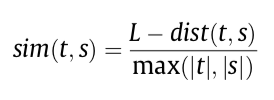
</div>

https://stackabuse.com/levenshtein-distance-and-text-similarity-in-python/

!pip install python-Levenshtein

In [354]:
import Levenshtein
Levenshtein.distance('abdominal wall', 'abdominal walls')

1

In [355]:
Levenshtein.distance('abdominal wall', 'wall of abdomen')

13

In [363]:
Levenshtein.distance('necrosis', 'tissue death')

11

In [366]:
Levenshtein.distance('abcdefghijklmn', 'opqrstuvwxyz')

14

In [356]:
Levenshtein.distance('gastrointestinal condition', 'gastrointestinal disorders')

9

In [357]:
Levenshtein.distance('anaphylaxis', 'allergic shock')

13

In [358]:
Levenshtein.distance('phenylketonuria', 'phenylketonuria (PKU)')

6

The higher the number the more edits need to be made to change one term to the other term. \
Levenshtein distance is also not good enough. While we want that ('abdominal wall', 'wall of abdomen') are seen as similar and ('necrosis', 'tissue death') different from each other, with the Levenshtein distance we can't set a threshold for this.

#### Fuzzy matching

(He et al., 2017 - Enriching consumer health vocabulary through mining a social Q&A site: A similarity-based approach) \
(Qenam et al., 2017 - Text Simplification Using Consumer Health Vocabulary to Generate Patient-Centered Radiology Reporting: Translation and Evaluation)

<div>
    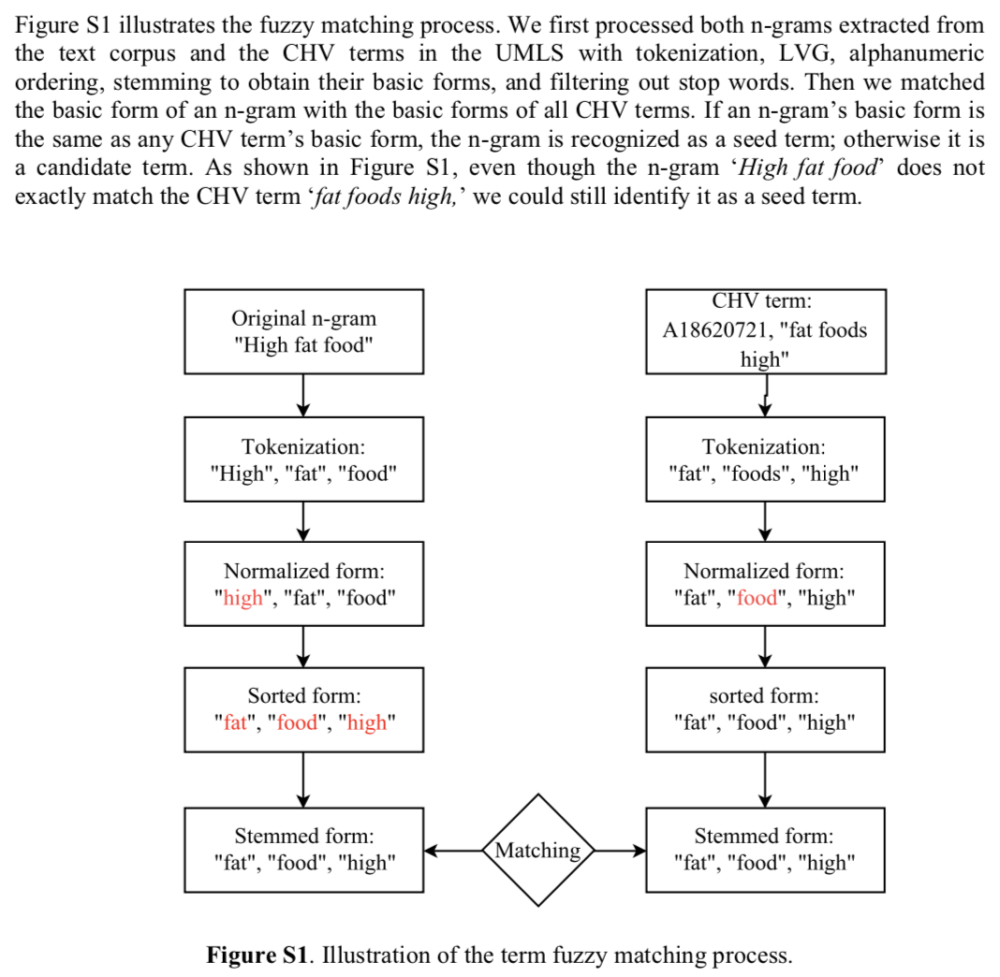
</div>

!pip install fuzzywuzzy

In [342]:
from fuzzywuzzy import fuzz
fuzz.token_sort_ratio('abdominal wall', 'wall of abdomen')

76

In [394]:
fuzz.token_sort_ratio('abdomen of wall', 'abdomin wall')

81

In [119]:
fuzz.token_sort_ratio('abdomen wall', 'abdomin wall')

92

In [389]:
fuzz.token_sort_ratio('wall abdomen', 'abdomen wall')

100

In [387]:
fuzz.token_sort_ratio('gastrointestinal condition', 'gastrointestinal disorder')

78

In [543]:
fuzz.token_sort_ratio('snakebite', 'snake bite')

53

In [544]:
Levenshtein.seqratio(['snakebite'], ['snake', 'bite'])

0.4761904761904762

In [545]:
Levenshtein.distance('snakebite', 'snake bite')

1

In [379]:
Levenshtein.seqratio(['abdominal', 'wall'], ['abdominal', 'wall'])

1.0

In [382]:
Levenshtein.seqratio(['wall', 'abdominal'], ['abdominal', 'wall'])

0.5

In [380]:
Levenshtein.seqratio(['abdomen', 'wall'], ['abdominal', 'wall'])

0.875

In [381]:
Levenshtein.seqratio(['gastrointestinal', 'condition'], ['gastrointestinal', 'disorder'])

0.6764705882352942

In [134]:
process_string("tuberculosis")

'tuberculosi'

In [135]:
process_string("tuberculous")

'tubercul'

"The fuzz.token functions have an important advantage over ratio and partial_ratio. They tokenize the strings and preprocess them by turning them to lower case and getting rid of punctuation. In the case of fuzz.token_sort_ratio(), the string tokens get sorted alphabetically and then joined together. After that, a simple fuzz.ratio() is applied to obtain the similarity percentage."

Our fuzzy matching process:
1. Tokenize term
2. Convert to lower cases and remove stopwords
3. Stem tokens using PorterStemmer from NLTK
5. Use token_sort_ratio method from fuzzywuzzy module to sort token and measure difference between the two strings

In [510]:
import nltk
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer

stopword_list = set(stopwords.words('english'))

ps = PorterStemmer()
    
def process_string(string):
    tokens = nltk.word_tokenize(string)
    rootWords = []
    for w in tokens:
        if w.lower() in stopword_list:
            continue
        rootWord = ps.stem(w)
        rootWords.append(rootWord)

    return ' '.join(rootWords)

def fuzzy_match(string1, string2):
    processed_string1 = process_string(string1)
    processed_string2 = process_string(string2)

    sim_score = fuzz.token_sort_ratio(processed_string1, processed_string2)
    return sim_score

sim_scores = []
for index, row in substitution_df.iterrows():
#     print(row["BERN_extracted_ngram"])
    if row["CHV_selected_term"] == None:
        sim_scores.append(None)
    else:
        sim_score = fuzzy_match(row["BERN_extracted_ngram"], row["CHV_selected_term"])
        sim_scores.append(sim_score)

substitution_df["sim_scores"] = sim_scores
substitution_df

,sentence,BERN_extracted_ngram,MESHtoCUIs,BERN_CUI_to_CHV_ID,BERN_CHV_terms,exact_match_CUIs,exact_match_CUI_to_CHV_ID,exact_match_CHV_terms,qumls_CUIs,qumls_CUI_to_CHV_ID,qumls_CHV_terms,CHV_preferred_terms,CHV_selected_term,sim_scores
sent_id,,,,,,,,,,,,,,
5,"In 1921, Buck's mother died of a tropical disease, sprue, and shortly afterward her father moved in.",tropical disease,[],[],[],[C1336827],[[]],[[]],"[C0445334, C0012634]",[[0000004014]],[[disease]],[[disease]],disease,63.0
6,"In 1920, the Bucks had a daughter, Carol, afflicted with phenylketonuria.",phenylketonuria,"[C0031485, C0751434, C0268465, C0751436, C0751435]","[[0000009618, 0000058151], [], [0000026313], [], [0000048432]]","[[phenylketonuria (PKU), phenylketonuria (PKU)], [], [dhpr deficiency], [], [hyperphenylalaninemia]]","[C0031485, C0751434]","[[0000009618, 0000058151], []]","[[phenylketonuria (PKU), phenylketonuria (PKU)], []]","[C0031485, C0031485, C0751434]","[[0000009618, 0000058151], [0000009618, 0000058151], []]","[[phenylketonuria (PKU), phenylketonuria (PKU)], [phenylketonuria (PKU), phenylketonuria (PKU)], []]","[[phenylketonuria (PKU), phenylketonuria (PKU)], []]",phenylketonuria (PKU),88.0
11,"Unable to function, the muscles weaken and exhibit atrophy.",atrophy,"[C2350270, C2350271]","[[], []]","[[], []]",[C0333641],"[[0000001574, 0000029786]]","[[atrophy, atrophic]]",[C0333641],"[[0000001574, 0000029786]]","[[atrophy, atrophic]]","[[atrophy, atrophic]]",atrophy,100.0
12,"About 75% of people contracting the disease experience ''limb onset'' ALS, i.e., first symptoms in the arms or legs.",ALS,"[C0002736, C0543859, C0393554]","[[0000001073], [], []]","[[Lou Gehrig's disease (ALS)], [], []]","[C0002736, C1704945, C1456383, C0003372]",[[0000001073]],[[Lou Gehrig's disease (ALS)]],[],[],[],[[Lou Gehrig's disease (ALS)]],Lou Gehrig's disease (ALS),17.0
16,North America and Australia have been free of FMD for many years.,FMD,[C0016052],[[0000005033]],[[fibromuscular dysplasia]],"[C0238288, C3810599, C4085863, C4281559, C0016052]","[[], [], [0000005033]]","[[], [], [fibromuscular dysplasia]]",[],[],[],"[[], [], [fibromuscular dysplasia]]",fibromuscular dysplasia,15.0
19,"There is an increased risk of STI transmission if the receiving partner has wounds on his genitals, or if the giving partner has wounds or open sores on or in his or her mouth, or bleeding gums.",STI,[],[],[],[C0036916],[[0000011285]],[[sexually transmitted diseases (STDs)]],[],[],[],[[sexually transmitted diseases (STDs)]],sexually transmitted diseases (STDs),21.0
30,"Hyssop is also used, usually in combination with other herbs such as liquorice, in herbal remedies, especially for lung conditions.",lung conditions,[C0024115],[[0000007568]],[[lung disease]],[],[],[],"[C0012634, C0024109]",[[0000004014]],[[disease]],[[lung disease]],lung disease,64.0
31,Skin allergy testing (such as patch testing) is available for certain foods and venoms.,Skin allergy,[],[],[],[C0585186],[[0000040756]],[[skin allergy]],[C0585186],[[0000040756]],[[skin allergy]],[[skin allergy]],skin allergy,100.0
34,Rarely very low blood pressure may be the only sign of anaphylaxis.,anaphylaxis,[C0002792],[[]],[[]],"[C0002792, C4316895]","[[], [0000001091]]","[[], [allergic shock]]","[C0002792, C4316895, C0002792, C4316895]","[[], [0000001091], [], [0000001091]]","[[], [allergic shock], [], [allergic shock]]","[[], [allergic shock]]",allergic shock,18.0


After manual inspection of the similarity scores and the difference between the source term and the selected substitution term, the threshold of >=85 for similarity scores seems to be the best cut off for similarity between the terms.

__Examples:__ \
6 In 1920, the Bucks had a daughter, Carol, afflicted with phenylketonuria. \
source term: phenylketonuria \
sub term: phenylketonuria (PKU) \
sim_score: 88

51 Those with underlying coronary disease are at greater risk of cardiac effects from anaphylaxis. \
source term: coronary disease \
sub term: coronary heart disease \
sim_score: 83

104 Tuberculosis typically attacks the lungs, but can also affect other parts of the body. \
source term: Tuberculosis \
sub term: tuberculosis (TB) \
sim_score: 88

107 Totally drug-resistant TB is resistant to all currently used drugs. \
source term: TB \
sub term: tuberculosis (TB) \
sim_score: 25

208 Not all virus infections produce a protective immune response in this way. \
source term: virus infections \
sub term: viral infection \
sim_score: 87

324 Stanisław Moniuszko died on 4 June 1872 in Warsaw of a sudden heart attack and was buried in Powązki Cemetery. \
source term: sudden heart attack \
sub term: heart attack \
sim_score: 77

435 Porter's mother died in 1952, and his wife died from emphysema in 1954. \
source term: emphysema \
sub term: lung emphysema \
sim_score: 78

1547 Feuermann died all too prematurely in 1942 due to complications in a surgical operation for hemorrhoids, short of his fortieth birthday. \
source term: hemorrhoids \
sub term: hemorrhoid (pile) \
sim_score: 80

1805 She died of Bright's disease on August 6, 1914. \
source term: Bright's disease \
sub term: glomerulonephritis \
sim_score: 14

1977 She was diagnosed with multiple sclerosis in October 1973. \
source term: multiple sclerosis \
sub term: multiple sclerosis (MS) \
sim_score: 91


#### Calculate percentages of lexical similarity

In [536]:
# Count 3 different classes of similarity score: None, substitution is different, substitution is similar
        
count_no_substitution = len(substitution_df.loc[substitution_df.sim_scores.isnull()])
count_sub_is_same = len(substitution_df.loc[substitution_df.sim_scores >= 85])
count_sub_is_different = len(substitution_df.loc[substitution_df.sim_scores < 85])

print(count_no_substitution)
print(count_sub_is_same)
print(count_sub_is_different)
print(count_no_substitution + count_sub_is_same + count_sub_is_different)
print(len(substitution_df))
assert len(substitution_df) == count_no_substitution + count_sub_is_same + count_sub_is_different

39
472
193
704
704


In [512]:
# Calculate percentages of the classes

print(f'No substitution found: {((count_no_substitution/len(substitution_df))*100):.1f}%')
print(f'Substitution is different: {((count_sub_is_different/len(substitution_df))*100):.1f}%')
print(f'Substitution is the same: {((count_sub_is_same/len(substitution_df))*100):.1f}%')

# OLD
# No substitution found: 5.4%
# Substitution is different: 25.7%
# Substitution is the same: 68.9%

No substitution found: 5.5%
Substitution is different: 27.4%
Substitution is the same: 67.0%


### Select sentences where both source term and sub term are a one word term

In [562]:
substitution_df.BERN_extracted_ngram.apply(lambda x: x.split())

sent_id
5                                                        [tropical, disease]
6                                                          [phenylketonuria]
11                                                                 [atrophy]
12                                                                     [ALS]
16                                                                     [FMD]
19                                                                     [STI]
30                                                        [lung, conditions]
31                                                           [Skin, allergy]
34                                                             [anaphylaxis]
39                                                             [anaphylaxis]
45                                                     [Anaphylactic, shock]
51                                                       [coronary, disease]
53                                                             [anap

In [630]:
substitution_df.loc[(substitution_df.BERN_extracted_ngram.apply(lambda x: len(x.split())) == 1) & \
                   (substitution_df.CHV_selected_term.apply(lambda x: len(x.split()) if x != None else -1) <= 1)]
#                    ((substitution_df.sim_scores < 85) | (substitution_df.sim_scores.isnull()))]

,sentence,BERN_extracted_ngram,MESHtoCUIs,BERN_CUI_to_CHV_ID,BERN_CHV_terms,exact_match_CUIs,exact_match_CUI_to_CHV_ID,exact_match_CHV_terms,qumls_CUIs,qumls_CUI_to_CHV_ID,qumls_CHV_terms,CHV_preferred_terms,CHV_selected_term,sim_scores
sent_id,,,,,,,,,,,,,,
11,"Unable to function, the muscles weaken and exhibit atrophy.",atrophy,"[C2350270, C2350271]","[[], []]","[[], []]",[C0333641],"[[0000001574, 0000029786]]","[[atrophy, atrophic]]",[C0333641],"[[0000001574, 0000029786]]","[[atrophy, atrophic]]","[[atrophy, atrophic]]",atrophy,100.0
59,Adenocarcinoma arises from glandular cells that are present at the junction of the esophagus and stomach.,Adenocarcinoma,"[C0001418, C0205641, C0205644, C0205642, C0205645, C0205643]","[[0000000709], [0000020662], [], [0000020663], [0000020665], [0000020664]]","[[adenocarcinoma], [basal cell adenocarcinoma], [], [hurthle cell carcinoma], [tubular carcinoma], [cribriform carcinoma]]",[C0001418],[[0000000709]],[[adenocarcinoma]],[C0001418],[[0000000709]],[[adenocarcinoma]],[[adenocarcinoma]],adenocarcinoma,100.0
72,"A hemophiliac does not bleed more intensely than a person without it, but can bleed for a much longer time.",hemophiliac,[],[],[],[C0259931],[],[],[C0684275],[[0000043976]],[[hemophilia]],[[hemophilia]],hemophilia,95.0
78,"Based on evidence of osteoarthritis in the lumbar vertebrae, eburnation, and severe wear on the teeth with pulp exposure, it seems likely that LM3 was quite old (around 50 years old) when he died.",osteoarthritis,"[C0029408, C0086743]","[[0000009068], [0000015996]]","[[osteoarthritis], [kaschin-beck disease]]",[C0029408],[[0000009068]],[[osteoarthritis]],[C0029408],[[0000009068]],[[osteoarthritis]],[[osteoarthritis]],osteoarthritis,100.0
101,In 1914 Adams's father died of a stroke.,stroke,"[C0038454, C0751956]","[[0000011781], [0000048516]]","[[stroke], [acute stroke]]",[C0038454],[[0000011781]],[[stroke]],[C0038454],[[0000011781]],[[stroke]],[[stroke]],stroke,100.0
110,"Sunderland, a main trading port at the time, was the first British town to be struck with the 'Indian cholera' epidemic.",cholera,[C0008354],[[0000002874]],[[cholera]],"[C0008354, C0008359]",[[0000002874]],[[cholera]],"[C0008354, C0008359, C0008354]","[[0000002874], [0000002874]]","[[cholera], [cholera]]",[[cholera]],cholera,100.0
111,"Local government was divided between the three parishes (Holy Trinity Church, Sunderland, St. Michael's, Bishopwearmouth, and St. Peter's, Monkwearmouth) and when cholera broke out in 1831, the ''select vestrymen'', as the church councilmen were called, were unable to cope with the epidemic.",cholera,[C0008354],[[0000002874]],[[cholera]],"[C0008354, C0008359]",[[0000002874]],[[cholera]],"[C0008354, C0008359, C0008354]","[[0000002874], [0000002874]]","[[cholera], [cholera]]",[[cholera]],cholera,100.0
112,"Once at Richmond, Madison began drafting the Report, though he was delayed by a weeklong battle with dysentery.",dysentery,[C0013369],"[[0000004203, 0000017297]]","[[dysentery, infectious diarrhea]]",[C0013369],"[[0000004203, 0000017297]]","[[dysentery, infectious diarrhea]]",[C0013369],"[[0000004203, 0000017297]]","[[dysentery, infectious diarrhea]]","[[dysentery, infectious diarrhea]]",dysentery,100.0
128,"By 1915, gangrene had set in and her entire right leg was amputated; she was required to use a wheelchair for several months.",gangrene,[C0017086],[[0000005347]],[[gangrene]],[C0017086],[[0000005347]],[[gangrene]],[C0017086],[[0000005347]],[[gangrene]],[[gangrene]],gangrene,100.0


## Pipeline to create substitution dataframes

In [172]:
import pandas as pd
from fuzzywuzzy import fuzz
import nltk
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from itertools import chain
from collections import OrderedDict
from collections import Counter

def get_sorted_voted_terms(exact_list, bern_list, qumls_list, exact_freq, bern_freq, qumls_freq):
    # Flatten the lists and converting them to sets
    exact_list_flat = OrderedDict(zip(chain(*exact_list), chain(*exact_freq)))
    bern_list_flat = OrderedDict(zip(chain(*bern_list), chain(*bern_freq)))
    qumls_list_flat = OrderedDict(zip(chain(*qumls_list), chain(*qumls_freq)))
    voted_terms = Counter(list(exact_list_flat.items()) + list(bern_list_flat.items()) + list(qumls_list_flat.items()))
    
    if bern_list_flat and not exact_list_flat and not qumls_list_flat:
        # if there's only BERN CHV results, don't consider sorting on freq. score
        sorted_voted_terms_on_freq_scores = sorted(voted_terms.items(), key= lambda t: (t[1]), reverse=True)
    elif qumls_list_flat and not exact_list_flat and not bern_list_flat:
        # if there's only QUMLS CHV results, don't consider sorting on freq. score
        sorted_voted_terms_on_freq_scores = sorted(voted_terms.items(), key= lambda t: (t[1]), reverse=True)
    else:
        # sort on overlap count (votes) and freq. score of terms
        sorted_voted_terms_on_freq_scores = sorted(voted_terms.items(), key= lambda t: (t[1], t[0][1]), reverse=True)
    
    return sorted_voted_terms_on_freq_scores    

def select_CHV_preferred_term(substitution_df):  
    CHV_selection = {}
    CHV_substitution = {}

    for index, row in substitution_df.iterrows():
        sorted_voted_terms = get_sorted_voted_terms(row["exact_match_CHV_terms"], row["BERN_CHV_terms"], row["qumls_CHV_terms"], \
                                                   row["exact_match_CHV_freq_scores"], row["BERN_CHV_freq_scores"], row["qumls_CHV_freq_scores"])    
        # print(sorted_voted_terms) # e.g. [(('tuberculous', 0.118189908), 3), (('tuberculosis (TB)', -1.0), 3)]

        ranked_terms = []
        for item in sorted_voted_terms:
            ranked_terms.append(item[0][0])
        CHV_selection[index] = ranked_terms

        takeLastTerm = False
        if len(sorted_voted_terms) > 1:
            
            for i in range(len(sorted_voted_terms)-1):
                takeLastTerm = True
                # If votes of current term is higher than votes of next term
                if sorted_voted_terms[i][1] > sorted_voted_terms[i+1][1]:
                    CHV_substitution[index] = sorted_voted_terms[i][0][0]
                    takeLastTerm = False
                    break
                    
                # If votes of current term and votes of next term are equal
                elif sorted_voted_terms[i][1] == sorted_voted_terms[i+1][1]:
                    # If the current term has a freq. score lower than the threshold, but not -1,
                    # AND the next term's freq. score is equal or higher than the threshold, or is -1,
                    # then continue to the next term.
                    if (sorted_voted_terms[i][0][1] < 0.5 and not sorted_voted_terms[i][0][1] == -1.0) \
                    and (sorted_voted_terms[i+1][0][1] >= 0.5 or sorted_voted_terms[i+1][0][1] == -1.0):
                        continue
                        
                    # Take current term which met the threshold criteria
                    CHV_substitution[index] = sorted_voted_terms[i][0][0]
                    takeLastTerm = False
                    break
                    
            if takeLastTerm == True:
                takeLastTerm = False
                CHV_substitution[index] = sorted_voted_terms[i+1][0][0]

        elif len(sorted_voted_terms) == 1:
            CHV_substitution[index] = sorted_voted_terms[0][0][0]
            
        else:
            CHV_substitution[index] = None

    substitution_df["CHV_selection"] = CHV_selection.values()
    substitution_df["CHV_substitution"] = CHV_substitution.values()
    
    return substitution_df
    
def process_string(string):
    stopword_list = set(stopwords.words('english'))
    ps = PorterStemmer()
    tokens = nltk.word_tokenize(string)
    rootWords = []
    for w in tokens:
        if w.lower() in stopword_list:
            continue
        rootWord = ps.stem(w)
        rootWords.append(rootWord)

    return ' '.join(rootWords)

def fuzzy_match(string1, string2):
    processed_string1 = process_string(string1)
    processed_string2 = process_string(string2)

    sim_score = fuzz.token_sort_ratio(processed_string1, processed_string2)
    return sim_score

def get_sim_score(substitution_df):
    sim_scores = []
    for index, row in substitution_df.iterrows():
        if row["CHV_substitution"] == None:
            sim_scores.append(None)
        else:
            sim_score = fuzzy_match(row["BERN_extracted_ngram"], row["CHV_substitution"])
            sim_scores.append(sim_score)

    substitution_df["sim_scores"] = sim_scores
    
    return substitution_df

def main():
    # Read data
    data = pd.read_csv("../sentence_extraction_and_entity_linking/output/subtitles/subtitles_bern_exact_qumls_oc(length)_th08_jaccard_withcontext.csv", sep=";", index_col=["origin","sent_id"])

    columns_to_convert = ['MESHtoCUIs',
                          'BERN_CUI_semtypes',
                          'BERN_CUI_to_CHV_ID',
                          'BERN_CHV_terms',
                          'BERN_CHV_freq_scores',
                          'exact_match_CUIs',
                          'exact_match_CUI_semtypes',
                          'exact_match_CUI_to_CHV_ID',
                          'exact_match_CHV_terms',
                          'exact_match_CHV_freq_scores',
                          'qumls_CUIs',
                          'qumls_extracted_ngrams',
                          'qumls_matched_terms',
                          'qumls_CUI_semtypes',
                          'qumls_CUI_to_CHV_ID',
                          'qumls_CHV_terms',
                          'qumls_CHV_freq_scores']

    # Convert selected columns into lists
    for i,column in enumerate(columns_to_convert):
        data[column] = data[column].apply(lambda x: eval(x))

    # Limiting columns in substitution dataframe
    substitution_df = data.drop(['entity_count',
                                 'BERN_entity_type',
                                 'msh_id',
                                 'BERN_CUI_semtypes',
                                 'exact_match_CUI_semtypes',
                                 'qumls_extracted_ngrams',
                                 'qumls_matched_terms',
                                 'qumls_CUI_semtypes',
                                ], axis=1)
    
    # Select one CHV term substitution for source term
    substitution_df = select_CHV_preferred_term(substitution_df)
    # Get similarity score between source term and substitution term
    substitution_df = get_sim_score(substitution_df)
    
    # Create a dataframe with only sentences that have a single word source term and single word substitution term (or no sub if CHV_sub <= 1)
    singlew_source_and_sub_df = substitution_df.loc[(substitution_df.BERN_extracted_ngram.apply(lambda x: len(x.split())) == 1) & \
                                            (substitution_df.CHV_substitution.apply(lambda x: len(x.split()) if x != None else -1) <= 1)]
    # Create a dataframe with only sentences that have a single word source term but can have a multi word substitution term (or no sub)
    singlew_source_df = substitution_df.loc[(substitution_df.BERN_extracted_ngram.apply(lambda x: len(x.split())) == 1)]
    
    # Save intermediate substitution dataframes
    substitution_df.to_csv('./output/subtitles/CHV_substitution_subtitles_intm.csv', sep=';')
    singlew_source_and_sub_df.to_csv('./output/subtitles/CHV_singlew_source_and_sub_subtitles_intm.csv', sep=';')
    singlew_source_df.to_csv('./output/subtitles/CHV_singlew_source_subtitles_intm.csv', sep=';')
    
    # Trim intermediate dataframes
    substitution_df = substitution_df[['sentence', 'BERN_extracted_ngram', 'CHV_selection', 'CHV_substitution', 'sim_scores']]
    substitution_df.rename(columns={'BERN_extracted_ngram':'source_term'}, inplace=True)
    
    singlew_source_and_sub_df = singlew_source_and_sub_df[['sentence', 'BERN_extracted_ngram', 'CHV_selection', 'CHV_substitution', 'sim_scores']]
    singlew_source_and_sub_df.rename(columns={'BERN_extracted_ngram':'source_term'}, inplace=True)
    
    singlew_source_df = singlew_source_df[['sentence', 'BERN_extracted_ngram', 'CHV_selection', 'CHV_substitution', 'sim_scores']]
    singlew_source_df.rename(columns={'BERN_extracted_ngram':'source_term'}, inplace=True)
    
    # Save final substitution dataframe
    substitution_df.to_csv('./output/subtitles/CHV_substitution_subtitles_final.csv', sep=';')
    singlew_source_and_sub_df.to_csv('./output/subtitles/CHV_singlew_source_and_sub_subtitles_final.csv', sep=';')
    singlew_source_df.to_csv('./output/subtitles/CHV_singlew_source_subtitles_final.csv', sep=';')
    
    # Count 3 different classes of similarity score: None, substitution is different, substitution is similar
    # For all subs
    count_no_substitution = len(substitution_df.loc[substitution_df.sim_scores.isnull()])
    count_sub_is_different = len(substitution_df.loc[(substitution_df.sim_scores < 85) & (substitution_df.sim_scores.notnull())])
    count_sub_is_same = len(substitution_df.loc[substitution_df.sim_scores >= 85])
    
    assert len(substitution_df) == count_no_substitution + count_sub_is_same + count_sub_is_different
    
    # For single word source and single word sub
    sw_source_sub_count_no_substitution = len(singlew_source_and_sub_df.loc[singlew_source_and_sub_df.sim_scores.isnull()])
    sw_source_sub_count_sub_is_different = len(singlew_source_and_sub_df.loc[(singlew_source_and_sub_df.sim_scores < 85) & (singlew_source_and_sub_df.sim_scores.notnull())])
    sw_source_sub_count_sub_is_same = len(singlew_source_and_sub_df.loc[singlew_source_and_sub_df.sim_scores >= 85])
    
    assert len(singlew_source_and_sub_df) == sw_source_sub_count_no_substitution + sw_source_sub_count_sub_is_different + sw_source_sub_count_sub_is_same
    
    # For single word source and multi word sub
    sw_source_count_no_substitution = len(singlew_source_df.loc[singlew_source_df.sim_scores.isnull()])
    sw_source_count_sub_is_different = len(singlew_source_df.loc[(singlew_source_df.sim_scores < 85) & (singlew_source_df.sim_scores.notnull())])
    sw_source_count_sub_is_same = len(singlew_source_df.loc[singlew_source_df.sim_scores >= 85])
    
    assert len(singlew_source_df) == sw_source_count_no_substitution + sw_source_count_sub_is_different + sw_source_count_sub_is_same
    
    # Calculate percentages of the classes
    print("All substitutions:")
    print("Number of sentences: ", len(substitution_df))
    print(f'No substitution found: {count_no_substitution} ({((count_no_substitution/len(substitution_df))*100):.1f}%)')
    print(f'Substitution is different: {count_sub_is_different} ({((count_sub_is_different/len(substitution_df))*100):.1f}%)')
    print(f'Substitution is the same: {count_sub_is_same} ({((count_sub_is_same/len(substitution_df))*100):.1f}%)')
    
    # Calculate percentages of the classes for single word source and single word substitution dataframe
    print("\nSingle word source, single word substitution:")
    print("Number of sentences: ", len(singlew_source_and_sub_df))
    print(f'No substitution found: {sw_source_sub_count_no_substitution} ({((sw_source_sub_count_no_substitution/len(singlew_source_and_sub_df))*100):.1f}%)')
    print(f'Substitution is different: {sw_source_sub_count_sub_is_different} ({((sw_source_sub_count_sub_is_different/len(singlew_source_and_sub_df))*100):.1f}%)')
    print(f'Substitution is the same: {sw_source_sub_count_sub_is_same} ({((sw_source_sub_count_sub_is_same/len(singlew_source_and_sub_df))*100):.1f}%)')
    
    # Calculate percentages of the classes for single word source and multi word substitution dataframe
    print("\nSingle word source, multiword substitution:")
    print("Number of sentences: ", len(singlew_source_df))
    print(f'No substitution found: {sw_source_count_no_substitution} ({((sw_source_count_no_substitution/len(singlew_source_df))*100):.1f}%)')
    print(f'Substitution is different: {sw_source_count_sub_is_different} ({((sw_source_count_sub_is_different/len(singlew_source_df))*100):.1f}%)')
    print(f'Substitution is the same: {sw_source_count_sub_is_same} ({((sw_source_count_sub_is_same/len(singlew_source_df))*100):.1f}%)')
    

In [173]:
main()

All substitutions:
Number of sentences:  9163
No substitution found: 817 (8.9%)
Substitution is different: 3054 (33.3%)
Substitution is the same: 5292 (57.8%)

Single word source, single word substitution:
Number of sentences:  4371
No substitution found: 653 (14.9%)
Substitution is different: 160 (3.7%)
Substitution is the same: 3558 (81.4%)

Single word source, multiword substitution:
Number of sentences:  6147
No substitution found: 653 (10.6%)
Substitution is different: 1925 (31.3%)
Substitution is the same: 3569 (58.1%)
